In [2]:
#libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')

In [3]:
#fetching data
import pandas as pd
data=pd.read_csv(r"C:\Users\malik\Downloads\census_income.csv")
data.head()

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
0,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
1,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
2,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
3,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
4,37,Private,284582,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K


In [4]:
pd.set_option('display.max_rows',None)

In [5]:
#data information
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32560 entries, 0 to 32559
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Age             32560 non-null  int64 
 1   Workclass       32560 non-null  object
 2   Fnlwgt          32560 non-null  int64 
 3   Education       32560 non-null  object
 4   Education_num   32560 non-null  int64 
 5   Marital_status  32560 non-null  object
 6   Occupation      32560 non-null  object
 7   Relationship    32560 non-null  object
 8   Race            32560 non-null  object
 9   Sex             32560 non-null  object
 10  Capital_gain    32560 non-null  int64 
 11  Capital_loss    32560 non-null  int64 
 12  Hours_per_week  32560 non-null  int64 
 13  Native_country  32560 non-null  object
 14  Income          32560 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [6]:
data.shape

(32560, 15)

In [7]:
data.columns

Index(['Age', 'Workclass', 'Fnlwgt', 'Education', 'Education_num',
       'Marital_status', 'Occupation', 'Relationship', 'Race', 'Sex',
       'Capital_gain', 'Capital_loss', 'Hours_per_week', 'Native_country',
       'Income'],
      dtype='object')

In [8]:
#data type
data.dtypes

Age                int64
Workclass         object
Fnlwgt             int64
Education         object
Education_num      int64
Marital_status    object
Occupation        object
Relationship      object
Race              object
Sex               object
Capital_gain       int64
Capital_loss       int64
Hours_per_week     int64
Native_country    object
Income            object
dtype: object

In [9]:
#data description
data.describe()

,Age,Fnlwgt,Education_num,Capital_gain,Capital_loss,Hours_per_week
count,32560.000000,3.256000e+04,32560.000000,32560.000000,32560.000000,32560.000000
mean,38.581634,1.897818e+05,10.080590,1077.615172,87.306511,40.437469
std,13.640642,1.055498e+05,2.572709,7385.402999,402.966116,12.347618
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178315e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783630e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.370545e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


In [10]:
#null values identification
data.isnull().sum()

Age               0
Workclass         0
Fnlwgt            0
Education         0
Education_num     0
Marital_status    0
Occupation        0
Relationship      0
Race              0
Sex               0
Capital_gain      0
Capital_loss      0
Hours_per_week    0
Native_country    0
Income            0
dtype: int64

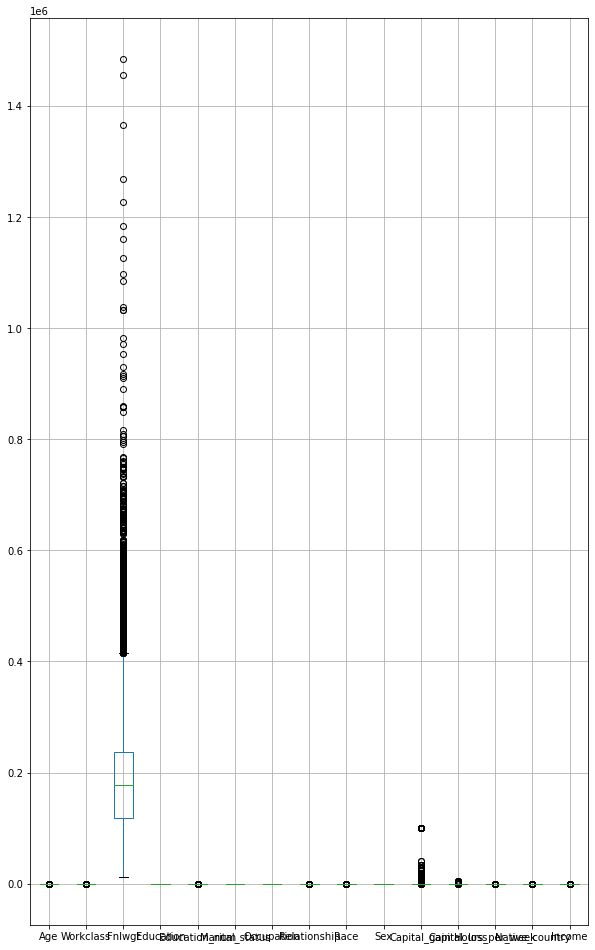

In [65]:
#for indentifying outliers
data.boxplot(figsize=[10,20])
plt.subplots_adjust(bottom=0.25)
plt.show()

<function matplotlib.pyplot.tight_layout(*, pad=1.08, h_pad=None, w_pad=None, rect=None)>

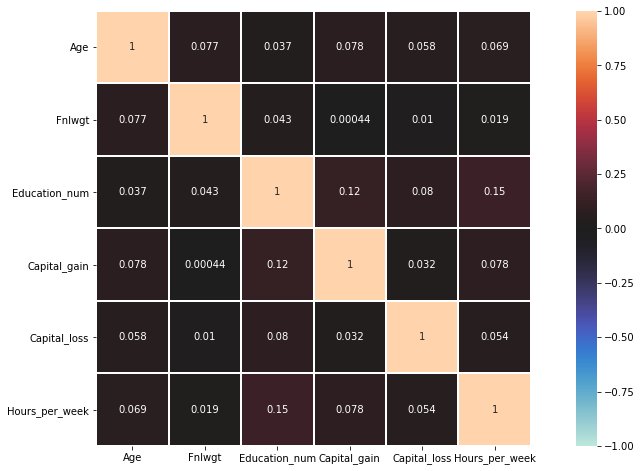

In [15]:
#identifying the corelation 
df_corr =data.corr().abs()
plt.figure(figsize=(16,8))
sns.heatmap(df_corr,  vmin=-1,annot=True,
           square=True,center=0,fmt='.2g',linewidths=1,)
plt.tight_layout

#converting object values to integers and float

In [16]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[[' Female', ' Male']])
df1 = ord_encoder.fit_transform(data[['Sex']])
df1

array([[1.],
       [1.],
       [1.],
       ...,
       [0.],
       [1.],
       [0.]])

In [17]:
data['Sex']=df1

In [18]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[[' Federal-gov', ' Self-emp-inc', ' Local-gov', ' Without-pay', ' Self-emp-not-inc', ' ?', ' Never-worked', ' Private', ' State-gov']])
df2 = ord_encoder.fit_transform(data[['Workclass']])
df2

array([[4.],
       [7.],
       [7.],
       ...,
       [7.],
       [7.],
       [1.]])

In [19]:
data['Workclass']=df2

In [20]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[[' Assoc-voc', ' Doctorate', ' 9th', ' 7th-8th', ' Preschool', ' Some-college', ' 1st-4th', ' 12th', ' 11th', ' Bachelors', ' Masters', ' 10th', ' Prof-school', ' 5th-6th', ' Assoc-acdm', ' HS-grad']])
df3 = ord_encoder.fit_transform(data[['Education']])
df3

array([[ 9.],
       [15.],
       [ 8.],
       ...,
       [15.],
       [15.],
       [15.]])

In [21]:
data['Education']=df3

In [22]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[[' Separated', ' Married-civ-spouse', ' Married-AF-spouse', ' Never-married', ' Divorced', ' Widowed', ' Married-spouse-absent']])
df4 = ord_encoder.fit_transform(data[['Marital_status']])
df4

array([[1.],
       [4.],
       [1.],
       ...,
       [5.],
       [3.],
       [1.]])

In [23]:
data['Marital_status']=df4

In [24]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[[' Protective-serv', ' Exec-managerial', ' Adm-clerical', ' Handlers-cleaners', ' ?', ' Priv-house-serv', ' Other-service', ' Transport-moving', ' Armed-Forces', ' Sales', ' Prof-specialty', ' Craft-repair', ' Tech-support', ' Farming-fishing', ' Machine-op-inspct']])
df5 = ord_encoder.fit_transform(data[['Occupation']])
df5

array([[1.],
       [3.],
       [3.],
       ...,
       [2.],
       [2.],
       [1.]])

In [25]:
data['Occupation']=df5

In [26]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[['<=50K', '>50K',' >50K', ' <=50K']])
df6 = ord_encoder.fit_transform(data[['Income']])
df6

array([[3.],
       [3.],
       [3.],
       ...,
       [3.],
       [3.],
       [2.]])

In [27]:
data['Income']=df6

In [28]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[[' Germany', ' Laos', ' ?', ' Ecuador', ' India', ' France', ' Hungary', ' Nicaragua', ' Columbia', ' Trinadad&Tobago', ' Jamaica', ' China', ' Outlying-US(Guam-USVI-etc)', ' Holand-Netherlands', ' Yugoslavia', ' South', ' Philippines', ' Scotland', ' Cambodia', ' Guatemala', ' Taiwan', ' United-States', ' Peru', ' Thailand', ' Haiti', ' Dominican-Republic', ' Puerto-Rico', ' Honduras', ' Poland', ' Vietnam', ' Mexico', ' El-Salvador', ' England', ' Hong', ' Ireland', ' Italy', ' Japan', ' Portugal', ' Canada', ' Greece', ' Cuba', ' Iran']])
df7 = ord_encoder.fit_transform(data[['Native_country']])
df7

array([[21.],
       [21.],
       [21.],
       ...,
       [21.],
       [21.],
       [21.]])

In [29]:
data['Native_country']=df7

In [30]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[[' Other', ' Asian-Pac-Islander', ' White', ' Amer-Indian-Eskimo', ' Black']])
df8 = ord_encoder.fit_transform(data[['Race']])
df8

array([[2.],
       [2.],
       [4.],
       ...,
       [2.],
       [2.],
       [2.]])

In [31]:
data['Race']=df8

In [32]:
from sklearn.preprocessing import OrdinalEncoder
ord_encoder=OrdinalEncoder(categories=[[' Wife', ' Own-child', ' Husband', ' Other-relative', ' Unmarried', ' Not-in-family']])
df9 = ord_encoder.fit_transform(data[['Relationship']])
df9

array([[2.],
       [5.],
       [2.],
       ...,
       [4.],
       [1.],
       [0.]])

In [33]:
data['Relationship']=df8

In [34]:
data

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
0,50,4.0,83311,9.0,13,1.0,1.0,2.0,2.0,1.0,0,0,13,21.0,3.0
1,38,7.0,215646,15.0,9,4.0,3.0,2.0,2.0,1.0,0,0,40,21.0,3.0
2,53,7.0,234721,8.0,7,1.0,3.0,4.0,4.0,1.0,0,0,40,21.0,3.0
3,28,7.0,338409,9.0,13,1.0,10.0,4.0,4.0,0.0,0,0,40,40.0,3.0
4,37,7.0,284582,10.0,14,1.0,1.0,2.0,2.0,0.0,0,0,40,21.0,3.0
5,49,7.0,160187,2.0,5,6.0,6.0,4.0,4.0,0.0,0,0,16,10.0,3.0
6,52,4.0,209642,15.0,9,1.0,1.0,2.0,2.0,1.0,0,0,45,21.0,2.0
7,31,7.0,45781,10.0,14,3.0,10.0,2.0,2.0,0.0,14084,0,50,21.0,2.0
8,42,7.0,159449,9.0,13,1.0,1.0,2.0,2.0,1.0,5178,0,40,21.0,2.0
9,37,7.0,280464,5.0,10,1.0,1.0,4.0,4.0,1.0,0,0,80,21.0,2.0


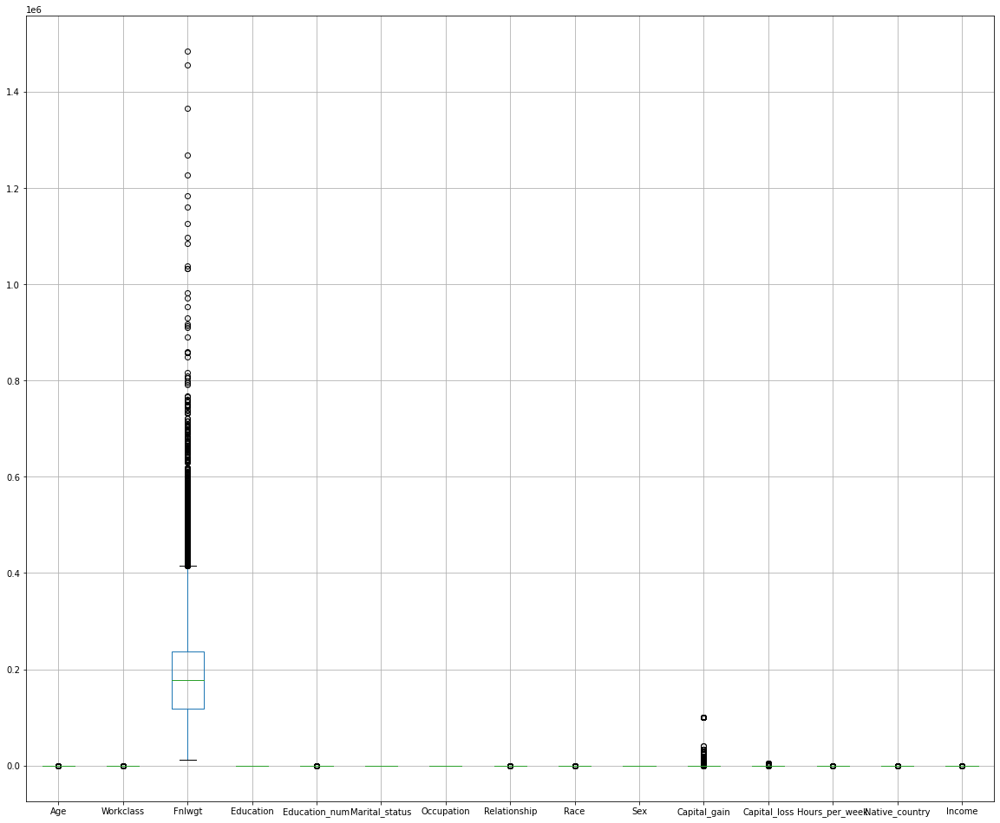

In [39]:
#for indentifying outliers
data.boxplot(figsize=[20,20])
plt.subplots_adjust(bottom=0.25)
plt.show()

In [ ]:
#removing outliers

<AxesSubplot:xlabel='Fnlwgt'>

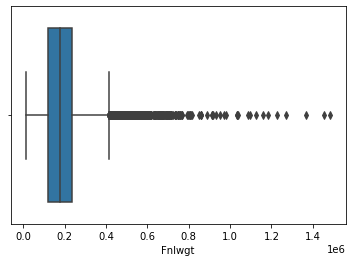

In [41]:
sns.boxplot(data['Fnlwgt'])

In [44]:
print(np.where(data['Fnlwgt']>0.4))

(array([    0,     1,     2, ..., 32557, 32558, 32559], dtype=int64),)


<AxesSubplot:xlabel='Capital_gain'>

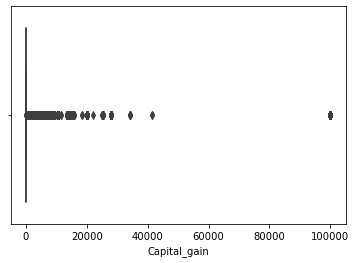

In [45]:
sns.boxplot(data['Capital_gain'])

In [46]:
print(np.where(data['Capital_gain']>0))

(array([    7,     8,    58, ..., 32537, 32547, 32559], dtype=int64),)


In [47]:
#checking skewness
data.skew()

Age                0.558738
Workclass         -1.631587
Fnlwgt             1.446972
Education         -0.263137
Education_num     -0.311630
Marital_status     0.418873
Occupation        -0.081382
Relationship       1.656354
Race               1.656354
Sex               -0.719244
Capital_gain      11.953690
Capital_loss       4.594549
Hours_per_week     0.227636
Native_country    -1.293190
Income            -1.212383
dtype: float64

In [64]:
#removing it
from sklearn.preprocessing import power_transform
df_new=power_transform(data)

df_new=pd.DataFrame(df_new,columns=data.columns)

In [49]:
df_new.skew()

Age              -0.013897
Workclass        -0.971637
Fnlwgt            0.016914
Education        -0.263706
Education_num     0.023885
Marital_status   -0.030259
Occupation       -0.248845
Relationship      0.091679
Race              0.091679
Sex              -0.719244
Capital_gain      3.016951
Capital_loss      4.299511
Hours_per_week    0.229556
Native_country    1.073118
Income           -1.212383
dtype: float64

In [50]:
#splitting data
y=data['Income']

x=data.drop(columns=['Income'])

In [51]:
#training the data 
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size = 0.25)

In [52]:
#agorithm use to predict the model
from sklearn.linear_model import LogisticRegression

log_reg = LogisticRegression()
log_reg.fit(x_train,y_train)

LogisticRegression()

In [53]:
y_pred=log_reg.predict(x_test)

In [54]:
accuracy=accuracy_score(y_test,y_pred)
accuracy

0.793980343980344

In [55]:
#agorithm use to predict the model
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(x_train,y_train)
predrf = rf.predict(x_test)

In [56]:
print(accuracy_score(y_test,predrf))

0.8535626535626536


In [57]:
print(confusion_matrix(y_test,predrf))

[[1205  758]
 [ 434 5743]]


In [58]:
print(classification_report(y_test,predrf))

              precision    recall  f1-score   support

         2.0       0.74      0.61      0.67      1963
         3.0       0.88      0.93      0.91      6177

    accuracy                           0.85      8140
   macro avg       0.81      0.77      0.79      8140
weighted avg       0.85      0.85      0.85      8140



In [59]:
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler()
X= sc.fit_transform(x)

In [60]:
#using dtc algoritm
from sklearn.tree import DecisionTreeClassifier
clf=DecisionTreeClassifier()
clf.fit(x_train,y_train)

DecisionTreeClassifier()

In [61]:
clf.score(x_train,y_train)

1.0

In [62]:
y_pred=clf.predict(x_test)

In [63]:
clf.score(x_test,y_test)

0.8143734643734644

In [45]:
# using support vector regression
from sklearn.svm import SVR
svr=SVR()
svr.fit(x_train,y_train)
ad_pred = svr.predict(x_test)

In [46]:
#accuracy score
print(accuracy_score(y_test,predrf))

0.8549140049140049


In [47]:
#use of matrix
print(confusion_matrix(y_test,predrf))

[[1258  741]
 [ 440 5701]]


In [48]:
#printing classification report 
print(classification_report(y_test,predrf))

              precision    recall  f1-score   support

         2.0       0.74      0.63      0.68      1999
         3.0       0.88      0.93      0.91      6141

    accuracy                           0.85      8140
   macro avg       0.81      0.78      0.79      8140
weighted avg       0.85      0.85      0.85      8140



In [49]:
#cross validation score
from sklearn.model_selection import cross_val_score
scr = cross_val_score(log_reg,x,y,cv=5)
print(scr.mean())

0.7958230958230958


In [50]:
#probability
probes = rf.predict_proba(x_test)

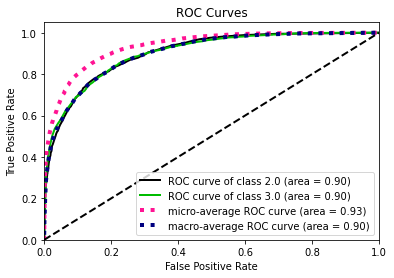

In [51]:
#roc curve
import scikitplot as skplt
skplt.metrics.plot_roc(y_test,probes)
plt.show()

In [53]:
#grid search cv
from sklearn.model_selection import GridSearchCV

In [54]:
#gridsearch cv
parameters={'n_estimators':[100,200],
           'max_features':['auto','sqrt','log2'],
           'max_depth':[4,5,6,7,8,9],
           'criterion':['gini','entropy']}

In [55]:
GCV=GridSearchCV(RandomForestClassifier(),parameters,cv=5)

In [56]:
GCV.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 5, 6, 7, 8, 9],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [100, 200]})

In [57]:
#best parameter checking
GCV.best_params_

{'criterion': 'gini',
 'max_depth': 9,
 'max_features': 'sqrt',
 'n_estimators': 100}

In [58]:
#applying best parameter
mod = RandomForestClassifier(criterion='gini',max_depth=9,max_features='sqrt',n_estimators=100)

In [59]:
#accuracy
mod.fit(x_train,y_train)
pred=mod.predict(x_test)
print(accuracy_score(y_test,pred))

0.8555282555282555


In [60]:
#model saving
import pickle

from sklearn import model_selection
filename = 'census.sav'
pickle.dump(data, open(filename, 'wb'))